importing library and data

In [1]:
import sklearn as skl
import matplotlib as plt
import pandas as pd
import numpy as np
from sklearn import datasets, linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler
import sklearn.preprocessing as preprocessing
from sklearn.decomposition import PCA
import csv
import seaborn as sns
from google.colab import drive
from sklearn.metrics import mean_squared_error, r2_score
import tensorflow as tf

drive.mount('/content/drive')
file_path = '/content/drive/MyDrive/energy_dataset.csv'

data = pd.read_csv(file_path)
data['time'] = pd.to_datetime(data['time'])
data.set_index('time', inplace=True)
data.head()

Mounted at /content/drive


<ipython-input-1-48ae46ad3c29>:23: FutureWarning: In a future version of pandas, parsing datetimes with mixed time zones will raise an error unless `utc=True`. Please specify `utc=True` to opt in to the new behaviour and silence this warning. To create a `Series` with mixed offsets and `object` dtype, please use `apply` and `datetime.datetime.strptime`
  data['time'] = pd.to_datetime(data['time'])


,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,generation hydro pumped storage aggregated,...,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
time,,,,,,,,,,,,,,,,,,,,,
2015-01-01 00:00:00+01:00,447.0,329.0,0.0,4844.0,4821.0,162.0,0.0,0.0,0.0,NaN,...,196.0,0.0,6378.0,17.0,NaN,6436.0,26118.0,25385.0,50.10,65.41
2015-01-01 01:00:00+01:00,449.0,328.0,0.0,5196.0,4755.0,158.0,0.0,0.0,0.0,NaN,...,195.0,0.0,5890.0,16.0,NaN,5856.0,24934.0,24382.0,48.10,64.92
2015-01-01 02:00:00+01:00,448.0,323.0,0.0,4857.0,4581.0,157.0,0.0,0.0,0.0,NaN,...,196.0,0.0,5461.0,8.0,NaN,5454.0,23515.0,22734.0,47.33,64.48
2015-01-01 03:00:00+01:00,438.0,254.0,0.0,4314.0,4131.0,160.0,0.0,0.0,0.0,NaN,...,191.0,0.0,5238.0,2.0,NaN,5151.0,22642.0,21286.0,42.27,59.32
2015-01-01 04:00:00+01:00,428.0,187.0,0.0,4130.0,3840.0,156.0,0.0,0.0,0.0,NaN,...,189.0,0.0,4935.0,9.0,NaN,4861.0,21785.0,20264.0,38.41,56.04


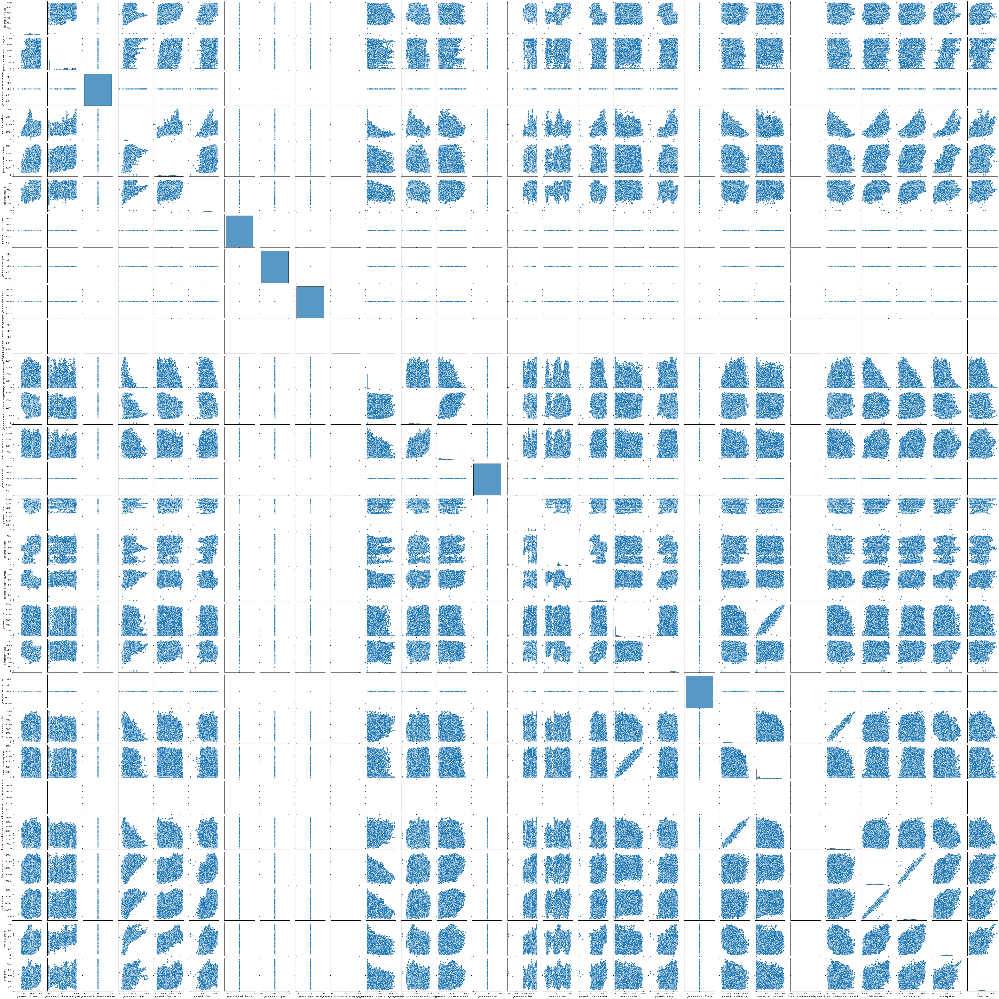

In [ ]:
sns.pairplot(data)

<Axes: >

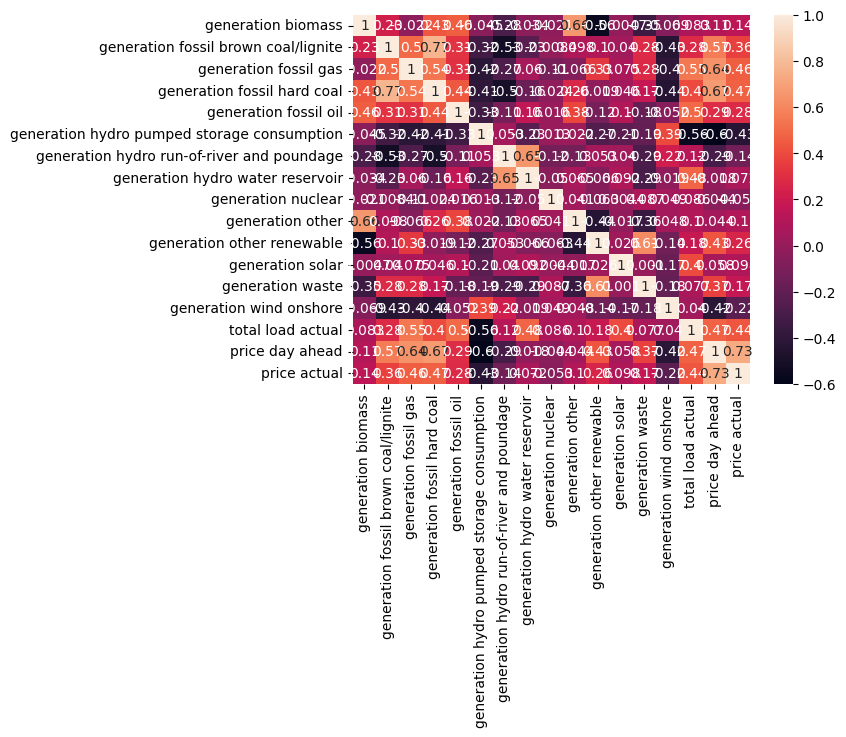

In [ ]:
sns.heatmap(data.corr(), annot=True)

In [2]:
data = data.drop(['generation fossil coal-derived gas',
                           'generation fossil oil shale',
                           'generation fossil peat',
                            'generation geothermal',
            'generation hydro pumped storage aggregated',
            'generation marine', 'generation wind offshore',
        'forecast wind offshore eday ahead', 'total load forecast',
        'forecast solar day ahead', 'forecast wind onshore day ahead'],
                          axis=1)
data.head()

,generation biomass,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation fossil oil,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,generation other,generation other renewable,generation solar,generation waste,generation wind onshore,total load actual,price day ahead,price actual
time,,,,,,,,,,,,,,,,,
2015-01-01 00:00:00+01:00,447.0,329.0,4844.0,4821.0,162.0,863.0,1051.0,1899.0,7096.0,43.0,73.0,49.0,196.0,6378.0,25385.0,50.10,65.41
2015-01-01 01:00:00+01:00,449.0,328.0,5196.0,4755.0,158.0,920.0,1009.0,1658.0,7096.0,43.0,71.0,50.0,195.0,5890.0,24382.0,48.10,64.92
2015-01-01 02:00:00+01:00,448.0,323.0,4857.0,4581.0,157.0,1164.0,973.0,1371.0,7099.0,43.0,73.0,50.0,196.0,5461.0,22734.0,47.33,64.48
2015-01-01 03:00:00+01:00,438.0,254.0,4314.0,4131.0,160.0,1503.0,949.0,779.0,7098.0,43.0,75.0,50.0,191.0,5238.0,21286.0,42.27,59.32
2015-01-01 04:00:00+01:00,428.0,187.0,4130.0,3840.0,156.0,1826.0,953.0,720.0,7097.0,43.0,74.0,42.0,189.0,4935.0,20264.0,38.41,56.04


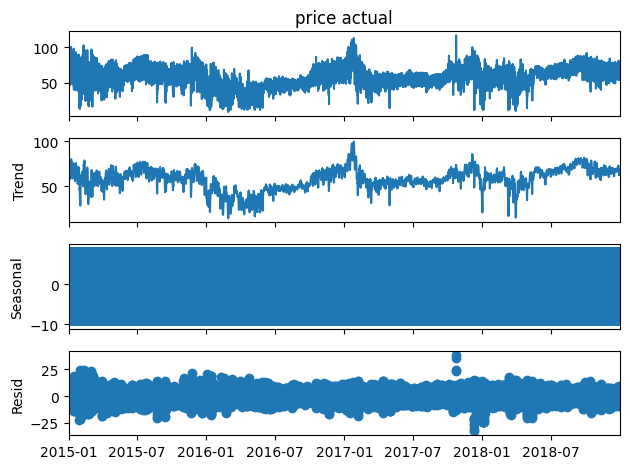

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

result = seasonal_decompose(data["price actual"], model="additive", period=24)  # Assuming hourly data
result.plot()
plt.show()

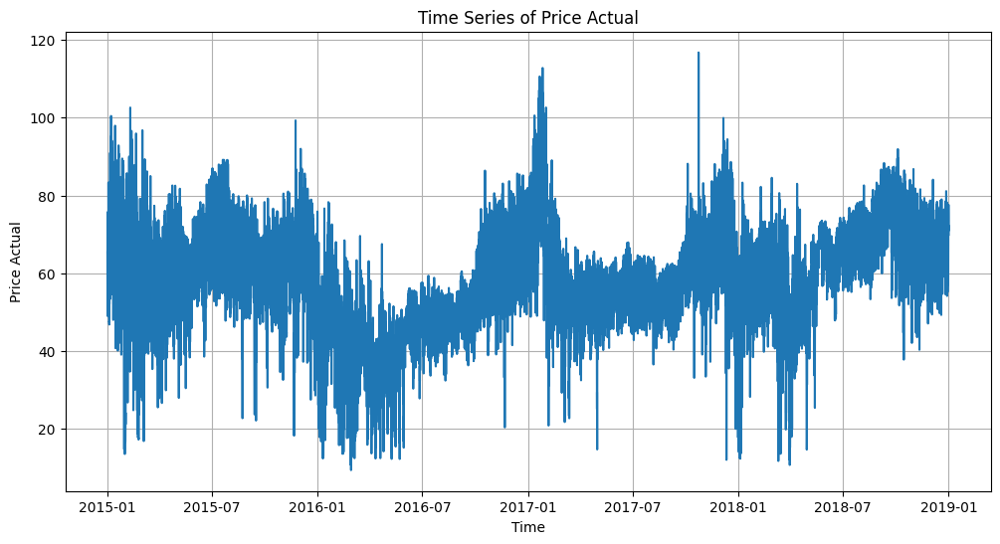

count    35064.000000
mean        57.884023
std         14.204083
min          9.330000
25%         49.347500
50%         58.020000
75%         68.010000
max        116.800000
Name: price actual, dtype: float64


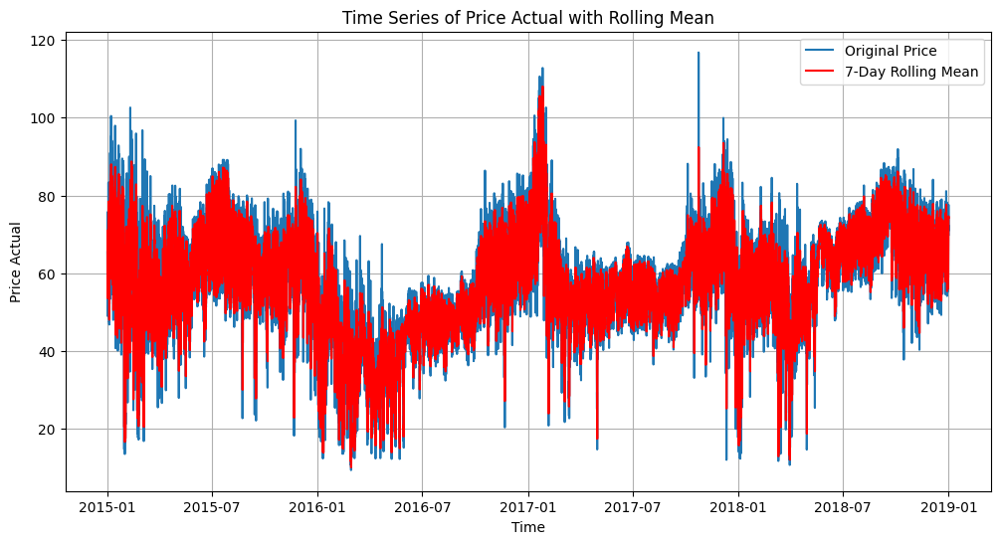

In [ ]:

# want to analyze it as a time series.

import matplotlib.pyplot as plt

# Plot the 'price actual' over time
plt.figure(figsize=(12, 6))
plt.plot(data['price actual'])
plt.xlabel('Time')
plt.ylabel('Price Actual')
plt.title('Time Series of Price Actual')
plt.grid(True)
plt.show()


# Calculate and print basic statistics for the 'price actual'
print(data['price actual'].describe())

# Example of using rolling mean to smooth the time series (adjust window size as needed)
data['rolling_mean'] = data['price actual'].rolling(window=7).mean()  # 7-day rolling mean

# Plot the smoothed time series
plt.figure(figsize=(12, 6))
plt.plot(data['price actual'], label='Original Price')
plt.plot(data['rolling_mean'], label='7-Day Rolling Mean', color='red')
plt.xlabel('Time')
plt.ylabel('Price Actual')
plt.title('Time Series of Price Actual with Rolling Mean')
plt.legend()
plt.grid(True)
plt.show()



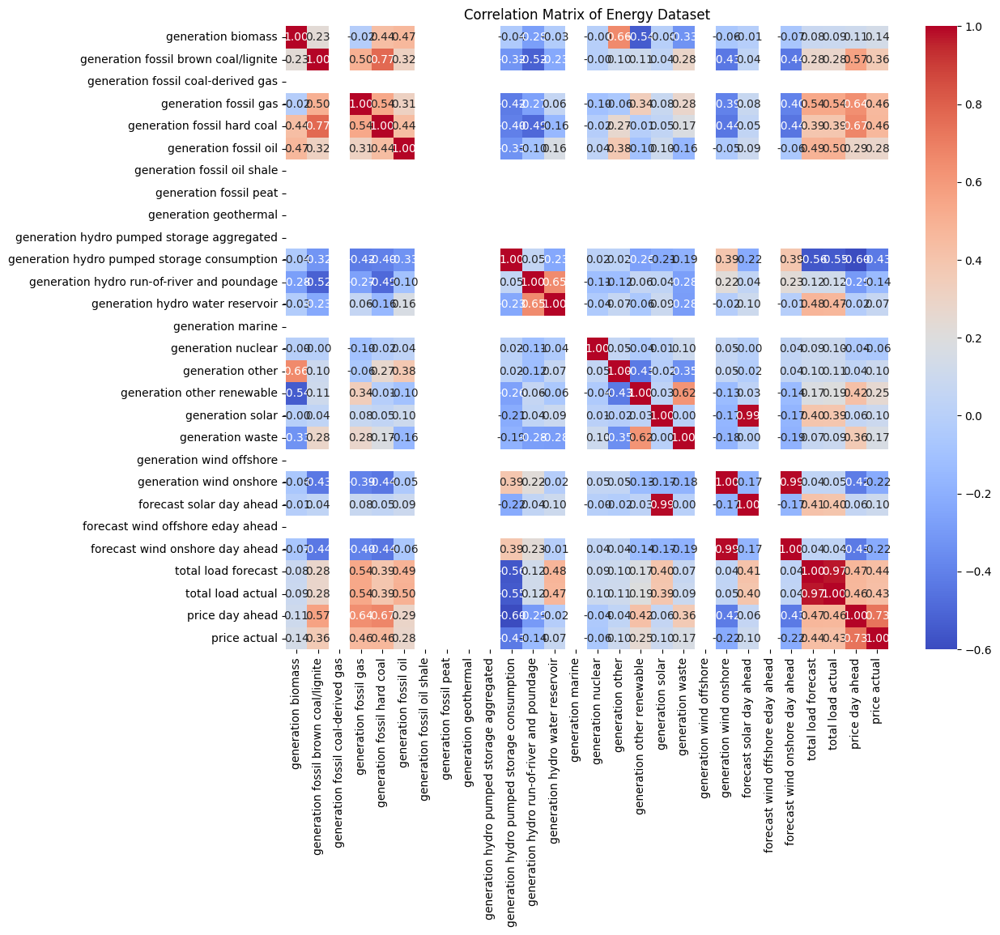

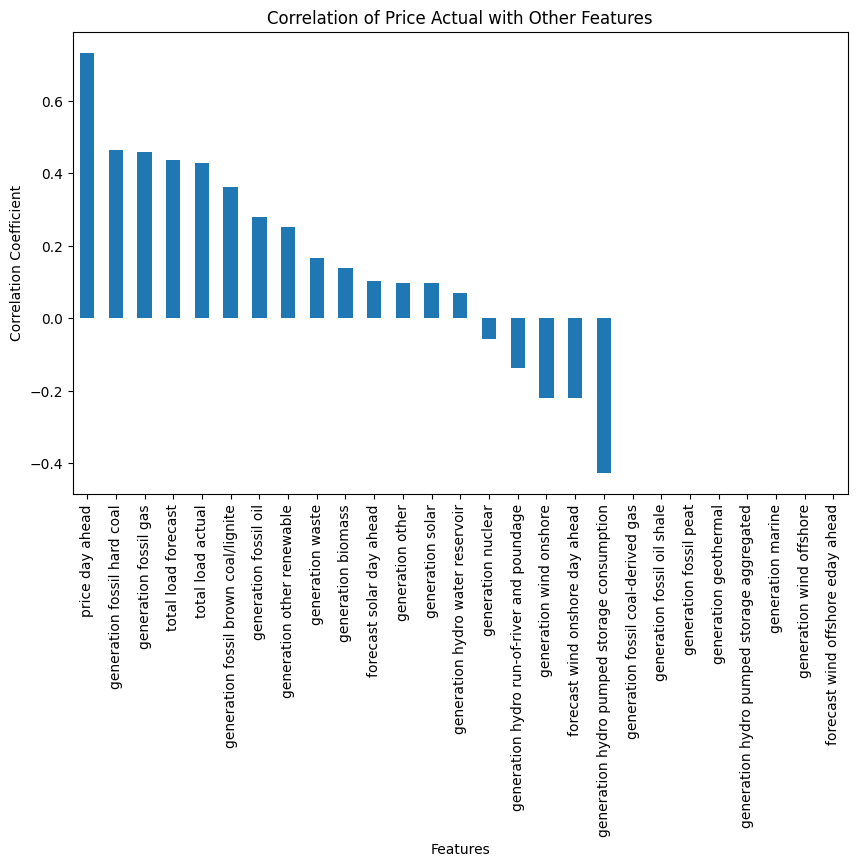

In [ ]:

# Calculate the correlation matrix
correlation_matrix = data.corr()

# Plot the correlation matrix using a heatmap
plt.pyplot.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.pyplot.title('Correlation Matrix of Energy Dataset')
plt.pyplot.show()

# Plot the correlation between price actual and other features
plt.pyplot.figure(figsize=(10, 6))
data.corr()['price actual'].sort_values(ascending=False).drop('price actual').plot(kind='bar')
plt.pyplot.title('Correlation of Price Actual with Other Features')
plt.pyplot.xlabel('Features')
plt.pyplot.ylabel('Correlation Coefficient')
plt.pyplot.show()


(35064, 16)
(35064,)
                           generation biomass  \
time                                            
2015-01-01 00:00:00+01:00               False   
2015-01-01 01:00:00+01:00               False   
2015-01-01 02:00:00+01:00               False   
2015-01-01 03:00:00+01:00               False   
2015-01-01 04:00:00+01:00               False   
...                                       ...   
2018-12-31 19:00:00+01:00               False   
2018-12-31 20:00:00+01:00               False   
2018-12-31 21:00:00+01:00               False   
2018-12-31 22:00:00+01:00               False   
2018-12-31 23:00:00+01:00               False   

                           generation fossil brown coal/lignite  \
time                                                              
2015-01-01 00:00:00+01:00                                 False   
2015-01-01 01:00:00+01:00                                 False   
2015-01-01 02:00:00+01:00                                 False   
2015-0

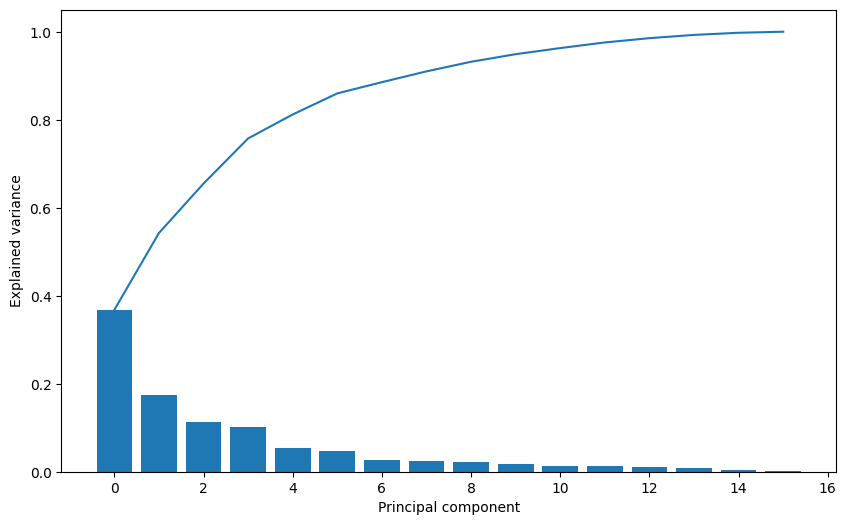

In [3]:
x_feature, y = data.drop("price actual", axis=1), data["price actual"]
print(x_feature.shape)
print(y.shape)
print(x_feature.isna())  # Detect NaN
print(x_feature.isna().sum())  # Count NaN
print(x_feature.columns[x_feature.isna().any()].tolist())
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy='mean')
x_feature = imputer.fit_transform(x_feature)
y_scalar = preprocessing.MinMaxScaler()
y = y_scalar.fit_transform(y.values.reshape(-1, 1))
scaler = preprocessing.MinMaxScaler()
x_feature = scaler.fit_transform(x_feature)



import matplotlib.pyplot as plt
#dimension reduction
pca = PCA()
eigen = pca.fit_transform(x_feature)
eigen = pd.DataFrame(eigen)
x_train,x_test,y_train,y_test = train_test_split(eigen,y,test_size=0.2,shuffle=False)
X_train = []
Y_train = []
for i in range(168, len(x_train)):
    X_train.append(x_train.iloc[i-168:i])
    Y_train.append(y_train[i, 0])
X_train, Y_train = np.array(X_train), np.array(Y_train)
X_train = X_train.reshape(X_train.shape[0], X_train.shape[1], X_train.shape[2])

num_components = len(pca.explained_variance_ratio_)
plt.figure(figsize=(10, 6))
plt.bar(np.arange(num_components), pca.explained_variance_ratio_)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Principal component')
plt.ylabel('Explained variance')
plt.show()


In [4]:
#test sliding window data
X_test = []
Y_test = []
for i in range(168,len(x_test)):
    X_test.append(x_test.iloc[i-168:i])
    Y_test.append(y_test[i,0])
X_test,Y_test = np.array(X_test),np.array(Y_test)
X_test = X_test.reshape(X_test.shape[0],X_test.shape[1],X_test.shape[2])


In [70]:
# train linear regression
model = LinearRegression()
model.fit(x_train,y_train)
print(model.score(x_train,y_train))
print(model.score(x_test,y_test))

0.5473879273768507
0.4776232724044315


In [5]:
#LSTM rnn time price forecasting hours forecast
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
model = Sequential()


model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2]))) # Changed input_shape
model.add(Dropout(0.2))
model.add(LSTM(units=50, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(units=50))
model.add(Dropout(0.2))
model.add(Dense(units=1))
model.compile(optimizer='adam', loss='mean_squared_error')
model.fit(X_train, Y_train, epochs=100, batch_size=32)
model.save('my_modelRNN3.keras')
!cp my_modelRNN3.keras /content/drive/MyDrive/

/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
872/872 ━━━━━━━━━━━━━━━━━━━━ 20s 18ms/step - loss: 0.0204
Epoch 2/100
872/872 ━━━━━━━━━━━━━━━━━━━━ 15s 18ms/step - loss: 0.0090
Epoch 3/100
872/872 ━━━━━━━━━━━━━━━━━━━━ 15s 18ms/step - loss: 0.0069
Epoch 4/100
872/872 ━━━━━━━━━━━━━━━━━━━━ 16s 18ms/step - loss: 0.0065
Epoch 5/100
872/872 ━━━━━━━━━━━━━━━━━━━━ 15s 17ms/step - loss: 0.0049
Epoch 6/100
872/872 ━━━━━━━━━━━━━━━━━━━━ 15s 17ms/step - loss: 0.0045
Epoch 7/100
872/872 ━━━━━━━━━━━━━━━━━━━━ 15s 18ms/step - loss: 0.0041
Epoch 8/100
872/872 ━━━━━━━━━━━━━━━━━━━━ 15s 17ms/step - loss: 0.0046
Epoch 9/100
872/872 ━━━━━━━━━━━━━━━━━━━━ 15s 17ms/step - loss: 0.0034
Epoch 10/100
872/872 ━━━━━━━━━━━━━━━━━━━━ 15s 17ms/step - loss: 0.0033
Epoch 11/100
872/872 ━━━━━━━━━━━━━━━━━━━━ 15s 18ms/step - loss: 0.0032
Epoch 12/100
872/872 ━━━━━━━━━━━━━━━━━━━━ 16s 18ms/step - loss: 0.0026
Epoch 13/100
872/872 ━━━━━━━━━━━━━━━━━━━━ 15s 18ms/step - loss: 0.0025
Epoch 14/100
872/872 ━━━━━━━━━━━━━━━━━━━━ 15s 18ms/step - loss: 0.0024
Epoch 15/100
87

one week forecasting data

In [9]:
from tensorflow.keras.models import load_model # Import the load_model function

model = load_model('my_modelRNN3.keras')
model.summary()
loss = model.evaluate(X_test, Y_test)
Y_predict = model.predict(X_test)
r2 = r2_score(Y_test, Y_predict)
print("Loss:", loss)
print("R-squared:", r2)
y_predict = y_scalar.inverse_transform(Y_predict)
y_test = y_scalar.inverse_transform(Y_test.reshape(-1, 1))

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                          │ (None, 168, 50)             │          13,400 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 168, 50)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ (None, 168, 50)             │          20,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 168, 50)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_2 (LSTM)                        │ (None, 50)                  │          20,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 50)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │              51 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 161,555 (631.08 KB)

 Trainable params: 53,851 (210.36 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 107,704 (420.72 KB)

214/214 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - loss: 0.0112
214/214 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
Loss: 0.009990332648158073
R-squared: 0.10783841450884313


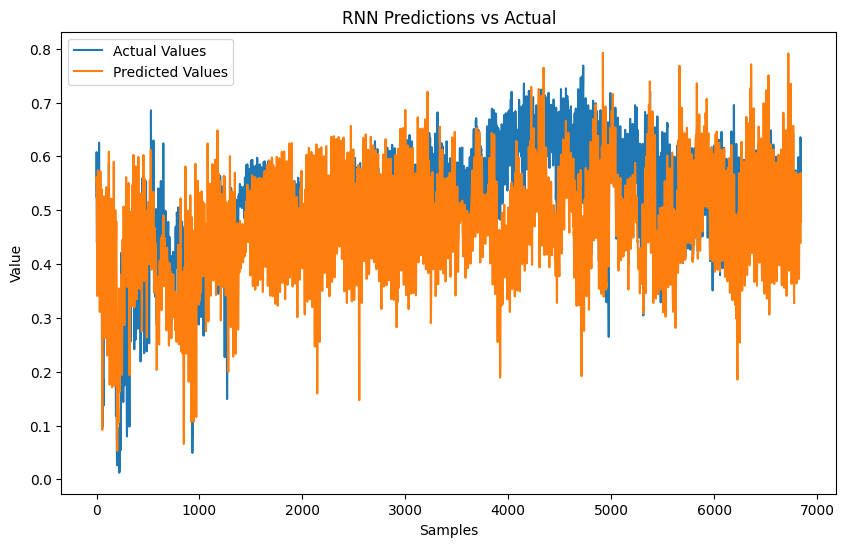

<ipython-input-10-884e626e8ecd>:16: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(Y_test.flatten(), label='Actual Values')
<ipython-input-10-884e626e8ecd>:17: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(Y_predict.flatten(), label='Predicted Values')


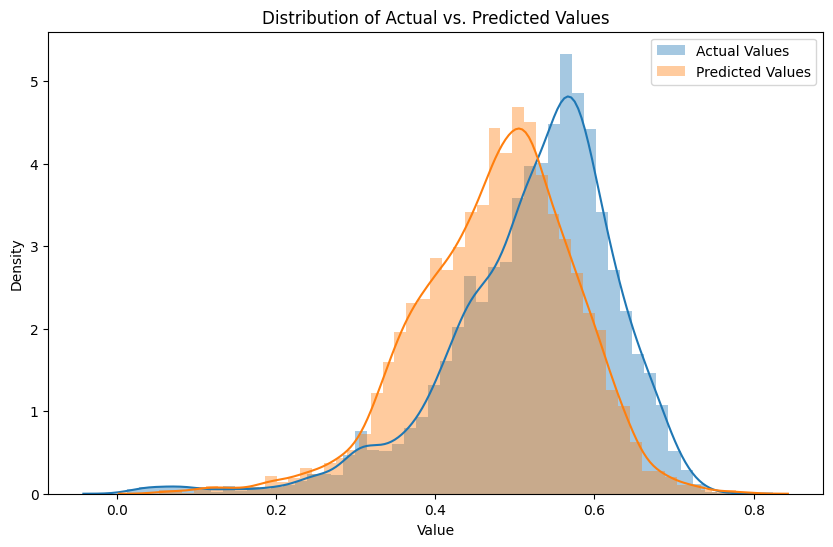

In [10]:
plt.figure(figsize=(10, 6))
sns.lineplot(x=np.arange(len(Y_test)), y=Y_test.flatten(), label='Actual Values') # Flattening y_test
sns.lineplot(x=np.arange(len(Y_predict)), y=Y_predict.flatten(), label='Predicted Values') # Flattening y_predict

plt.title('RNN Predictions vs Actual')
plt.xlabel('Samples')
plt.ylabel('Value')
plt.legend()
plt.show()
# normal distribution of test and pred

import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
sns.distplot(Y_test.flatten(), label='Actual Values')
sns.distplot(Y_predict.flatten(), label='Predicted Values')

plt.title('Distribution of Actual vs. Predicted Values')
plt.xlabel('Value')
plt.ylabel('Density')
plt.legend()
plt.show()

4 hour forecasting

In [77]:
model = load_model('my_modelRNN2.keras')
model.summary()
loss = model.evaluate(X_test, Y_test)
Y_predict = model.predict(X_test)
r2 = r2_score(Y_test, Y_predict)
print("Loss:", loss)
print("R-squared:", r2)
y_predict = y_scalar.inverse_transform(Y_predict)
y_test = y_scalar.inverse_transform(Y_test.reshape(-1, 1))

Model: "sequential_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_30 (LSTM)                       │ (None, 4, 50)               │          13,400 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_30 (Dropout)                 │ (None, 4, 50)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_31 (LSTM)                       │ (None, 4, 50)               │          20,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_31 (Dropout)                 │ (None, 4, 50)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_32 (LSTM)                       │ (None, 50)                  │          20,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_32 (Dropout)                 │ (None, 50)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ (None, 1)                   │              51 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 161,555 (631.08 KB)

 Trainable params: 53,851 (210.36 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 107,704 (420.72 KB)

220/220 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0180
220/220 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Loss: 0.020509138703346252
R-squared: -0.7659187865978871


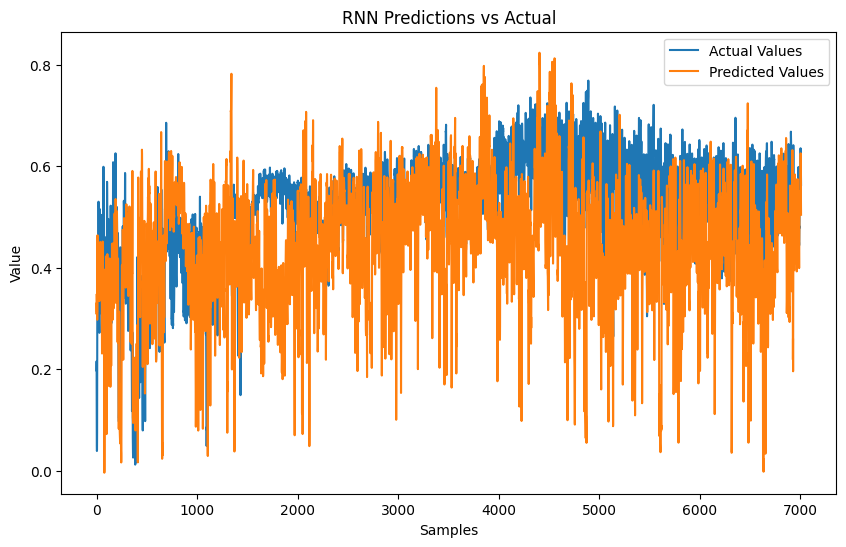

<ipython-input-78-884e626e8ecd>:16: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(Y_test.flatten(), label='Actual Values')
<ipython-input-78-884e626e8ecd>:17: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(Y_predict.flatten(), label='Predicted Values')


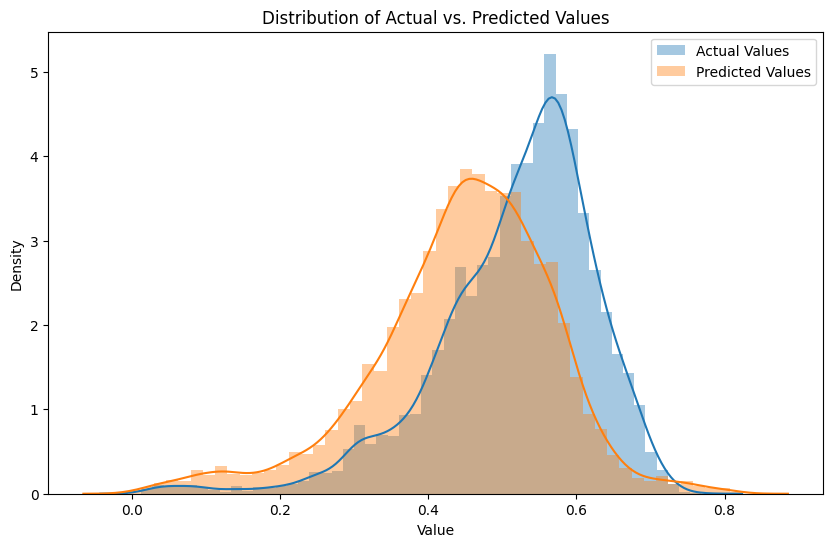

In [78]:
plt.figure(figsize=(10, 6))
sns.lineplot(x=np.arange(len(Y_test)), y=Y_test.flatten(), label='Actual Values') # Flattening y_test
sns.lineplot(x=np.arange(len(Y_predict)), y=Y_predict.flatten(), label='Predicted Values') # Flattening y_predict

plt.title('RNN Predictions vs Actual')
plt.xlabel('Samples')
plt.ylabel('Value')
plt.legend()
plt.show()
# normal distribution of test and pred

import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
sns.distplot(Y_test.flatten(), label='Actual Values')
sns.distplot(Y_predict.flatten(), label='Predicted Values')

plt.title('Distribution of Actual vs. Predicted Values')
plt.xlabel('Value')
plt.ylabel('Density')
plt.legend()
plt.show()

12 hour forecasting


In [65]:
#sliding window 12 hr version
model = load_model('my_modelRNN1.keras')
model.summary()
loss = model.evaluate(X_test, Y_test)
Y_predict = model.predict(X_test)
r2 = r2_score(Y_test, Y_predict)
print("Loss:", loss)
print("R-squared:", r2)
y_predict = y_scalar.inverse_transform(Y_predict)
y_test = y_scalar.inverse_transform(Y_test.reshape(-1, 1))


Model: "sequential_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_24 (LSTM)                       │ (None, 12, 50)              │          13,400 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_24 (Dropout)                 │ (None, 12, 50)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_25 (LSTM)                       │ (None, 12, 50)              │          20,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_25 (Dropout)                 │ (None, 12, 50)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_26 (LSTM)                       │ (None, 50)                  │          20,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_26 (Dropout)                 │ (None, 50)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 1)                   │              51 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 161,555 (631.08 KB)

 Trainable params: 53,851 (210.36 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 107,704 (420.72 KB)

219/219 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0162
219/219 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Loss: 0.020003775134682655
R-squared: -0.7518778219402282


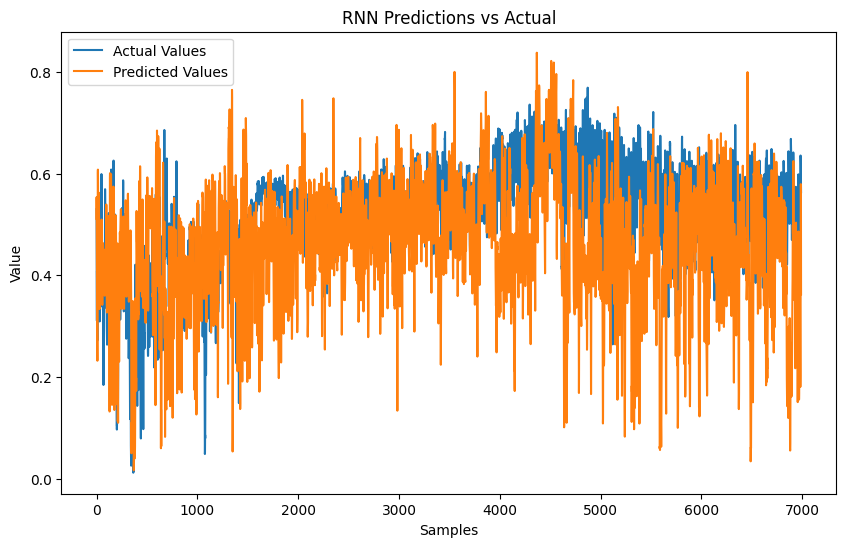

<ipython-input-64-884e626e8ecd>:16: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(Y_test.flatten(), label='Actual Values')
<ipython-input-64-884e626e8ecd>:17: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(Y_predict.flatten(), label='Predicted Values')


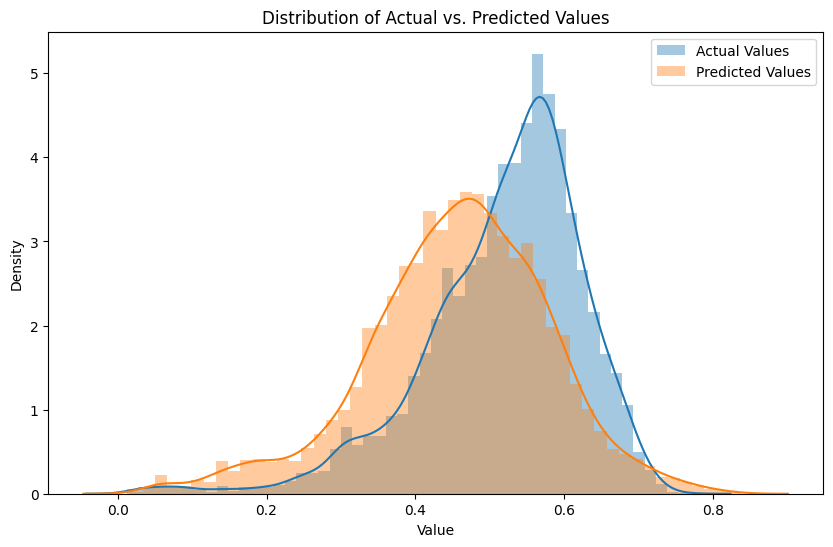

In [64]:
plt.figure(figsize=(10, 6))
sns.lineplot(x=np.arange(len(Y_test)), y=Y_test.flatten(), label='Actual Values') # Flattening y_test
sns.lineplot(x=np.arange(len(Y_predict)), y=Y_predict.flatten(), label='Predicted Values') # Flattening y_predict

plt.title('RNN Predictions vs Actual')
plt.xlabel('Samples')
plt.ylabel('Value')
plt.legend()
plt.show()
# normal distribution of test and pred

import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
sns.distplot(Y_test.flatten(), label='Actual Values')
sns.distplot(Y_predict.flatten(), label='Predicted Values')

plt.title('Distribution of Actual vs. Predicted Values')
plt.xlabel('Value')
plt.ylabel('Density')
plt.legend()
plt.show()

sliding window 24hr sequence dataset

In [66]:
#sliding window version
model = load_model('my_modelRNN.keras')
model.summary()
loss = model.evaluate(X_test, Y_test)
Y_predict = model.predict(X_test)
r2 = r2_score(Y_test, Y_predict)
print("Loss:", loss)
print("R-squared:", r2)
y_predict = y_scalar.inverse_transform(Y_predict)
y_test = y_scalar.inverse_transform(Y_test.reshape(-1, 1))


Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_21 (LSTM)                       │ (None, 24, 50)              │          13,400 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_21 (Dropout)                 │ (None, 24, 50)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_22 (LSTM)                       │ (None, 24, 50)              │          20,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_22 (Dropout)                 │ (None, 24, 50)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_23 (LSTM)                       │ (None, 50)                  │          20,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_23 (Dropout)                 │ (None, 50)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 1)                   │              51 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 161,555 (631.08 KB)

 Trainable params: 53,851 (210.36 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 107,704 (420.72 KB)

219/219 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0125
219/219 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Loss: 0.016964005306363106
R-squared: -0.48566326475128063


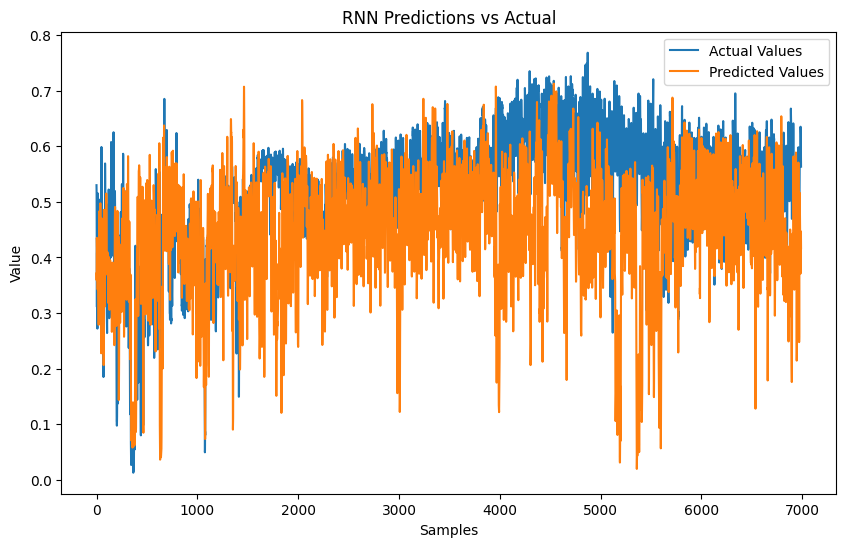

<ipython-input-57-884e626e8ecd>:16: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(Y_test.flatten(), label='Actual Values')
<ipython-input-57-884e626e8ecd>:17: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(Y_predict.flatten(), label='Predicted Values')


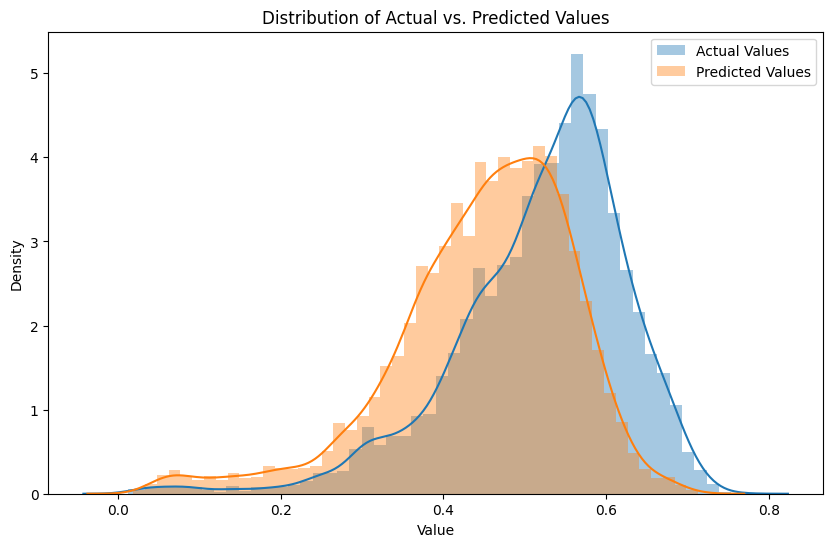

In [57]:
plt.figure(figsize=(10, 6))
sns.lineplot(x=np.arange(len(Y_test)), y=Y_test.flatten(), label='Actual Values') # Flattening y_test
sns.lineplot(x=np.arange(len(Y_predict)), y=Y_predict.flatten(), label='Predicted Values') # Flattening y_predict

plt.title('RNN Predictions vs Actual')
plt.xlabel('Samples')
plt.ylabel('Value')
plt.legend()
plt.show()
# normal distribution of test and pred

import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
sns.distplot(Y_test.flatten(), label='Actual Values')
sns.distplot(Y_predict.flatten(), label='Predicted Values')

plt.title('Distribution of Actual vs. Predicted Values')
plt.xlabel('Value')
plt.ylabel('Density')
plt.legend()
plt.show()

In [22]:
#training with no sequence length
from tensorflow.keras.models import load_model
model_path ='/content/drive/MyDrive/my_model.keras'
model = load_model(model_path)

model.summary()
loss = model.evaluate(x_test, y_test)
y_predict = model.predict(x_test)
r2 = r2_score(y_test, y_predict)
print("Loss:", loss)
print("R-squared:", r2)
y_predict = y_scalar.inverse_transform(y_predict)
y_test = y_scalar.inverse_transform(y_test)

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_6 (LSTM)                        │ (None, 16, 50)              │          10,400 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_6 (Dropout)                  │ (None, 16, 50)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_7 (LSTM)                        │ (None, 16, 50)              │          20,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_7 (Dropout)                  │ (None, 16, 50)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_8 (LSTM)                        │ (None, 50)                  │          20,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_8 (Dropout)                  │ (None, 50)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 1)                   │              51 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 152,555 (595.92 KB)

 Trainable params: 50,851 (198.64 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 101,704 (397.29 KB)

220/220 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0016
220/220 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Loss: 0.0014188698260113597
R-squared: 0.8778624863420339


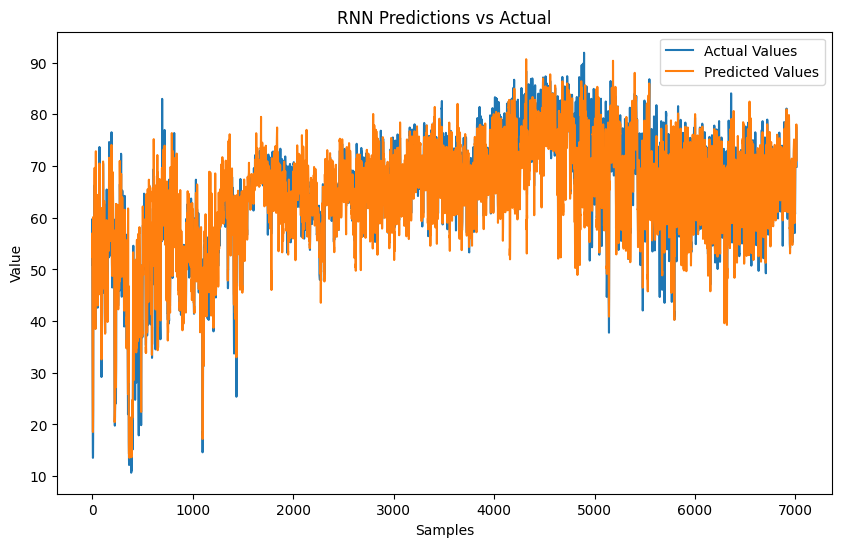

In [23]:
plt.figure(figsize=(10, 6))
sns.lineplot(x=np.arange(len(y_test)), y=y_test.flatten(), label='Actual Values') # Flattening y_test
sns.lineplot(x=np.arange(len(y_predict)), y=y_predict.flatten(), label='Predicted Values') # Flattening y_predict

plt.title('RNN Predictions vs Actual')
plt.xlabel('Samples')
plt.ylabel('Value')
plt.legend()
plt.show()

<ipython-input-24-be20b419f442>:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(y_test.flatten(), label='Actual Values')
<ipython-input-24-be20b419f442>:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(y_predict.flatten(), label='Predicted Values')


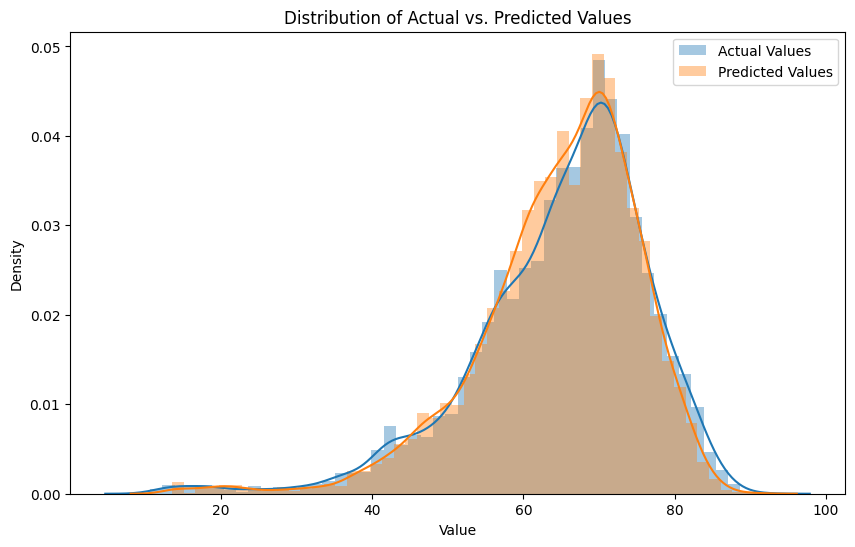

In [24]:
# normal distribution of test and pred

import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
sns.distplot(y_test.flatten(), label='Actual Values')
sns.distplot(y_predict.flatten(), label='Predicted Values')

plt.title('Distribution of Actual vs. Predicted Values')
plt.xlabel('Value')
plt.ylabel('Density')
plt.legend()
plt.show()


In [ ]:
#implement weather dataset?
file_path = '/content/drive/MyDrive/weather.csv'

data = pd.read_csv(file_path)
data.head()
sns.pairplot(data)